In [1]:
import numpy as np
import pandas as pd
import os 
import matplotlib.pyplot as plt
import umap
import seaborn as sns
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
import matplotlib

from scroutines import config_plots
from scroutines import basicu
from scroutines import miscu

In [2]:
import sys
sys.setrecursionlimit(10000)
from scipy.cluster import hierarchy as sch

In [3]:
pth_dat = '/u/home/f/f7xiesnm/project-zipursky/easifish/lt172/proc/test-oct6_epsilon1/'
!ls $pth_dat

bad_roi_list.npy  roi_all.csv  spotcount.csv	   spotcount_merged.csv
clustering.csv	  roi.csv      spotcount_intn.csv


In [4]:
gene_names = {
    'r1_c0': 'Sorcs3',
    'r1_c1': 'Kcnq5',
    'r1_c2': 'Chrm2',
    'r1_c4': 'Adamts2',
    
    # 'r2_c0': 'Kcnip3',
    # 'r2_c1': 'Rorb',
    # 'r2_c2': 'Cdh13',
    # 'r2_c4': 'Cntn5',
    
    'r3_c0': 'Cdh12',
    'r3_c1': 'Gria3',
    'r3_c2': 'Cntnap2',
    'r3_c4': 'Gabrg3',
    
    'r4_c0': 'Kcnh5',
    'r4_c1': 'Cre',
    'r4_c2': 'Slc17a7',
    'r4_c4': 'Grm8',
    
    'r5_c0': 'Ncam2',
    'r5_c1': 'Rfx3',
    'r5_c2': 'Epha10',
    'r5_c4': 'Baz1a',
}
channel_names = pd.Series(gene_names).reset_index().set_index(0)['index']
ftrs_order = list(gene_names.keys())

genes_order = [gene_names[ftr] for ftr in ftrs_order]
genes_order

['Sorcs3',
 'Kcnq5',
 'Chrm2',
 'Adamts2',
 'Cdh12',
 'Gria3',
 'Cntnap2',
 'Gabrg3',
 'Kcnh5',
 'Cre',
 'Slc17a7',
 'Grm8',
 'Ncam2',
 'Rfx3',
 'Epha10',
 'Baz1a']

In [5]:
f_meta = os.path.join(pth_dat, 'roi.csv')
f_ftrs = os.path.join(pth_dat, 'spotcount_merged.csv')

In [6]:
meta = pd.read_csv(f_meta, index_col=0)
ftrs = pd.read_csv(f_ftrs, index_col=0)
df = ftrs.join(meta).dropna()
ftrs_cols = ftrs.columns.values
print(meta.shape, ftrs.shape, df.shape)

(9723, 4) (9723, 16) (9723, 20)


In [7]:
max_x, max_y, max_z = df[['x', 'y', 'z']].describe().loc['max']
min_x, min_y, min_z = df[['x', 'y', 'z']].describe().loc['min']
print(min_x, max_x)
print(min_y, max_y)
print(min_z, max_z)
df['to_edge'] = np.minimum(
    np.minimum(df['x']-min_x, max_x-df['x']), 
    np.minimum(df['y']-min_y, max_y-df['y']), 
    np.minimum(df['z']-min_z, max_z-df['z']),
)

for col in ftrs_cols:
    val = df[col].values
    print(f'{np.min(val)}, {np.max(val):.1f}, {np.sum(val>0)/len(df):.3f}')

18.4978443768997 406.8085888324873
13.173567370129872 377.2643202868241
1.3385115020297698 351.1794604003481
0.0, 70.0, 0.736
0.0, 749.5, 0.952
0.0, 74.0, 0.639
0.0, 29.0, 0.322
0.0, 95.0, 0.961
0.0, 508.6, 0.959
0.0, 103.0, 0.899
0.0, 40.0, 0.565
0.0, 291.2, 0.954
0.0, 1406.3, 0.837
0.0, 2357.6, 0.985
0.0, 34.0, 0.669
0.0, 155.0, 0.959
0.0, 1116.4, 0.944
0.0, 72.0, 0.921
0.0, 29.0, 0.230


In [8]:
########### FLIP y!
df['y'] = max_y -df['y']
max_x, max_y, max_z = df[['x', 'y', 'z']].describe().loc['max']
min_x, min_y, min_z = df[['x', 'y', 'z']].describe().loc['min']
print(min_x, max_x)
print(min_y, max_y)
print(min_z, max_z)

18.4978443768997 406.8085888324873
0.0 364.0907529166942
1.3385115020297698 351.1794604003481


In [9]:
# remove outliers
conds = [
    df['area'] > 500,
    df['x'] > min_x + 10,
    df['x'] < max_x - 10,
    
    df['y'] > min_y + 10,
    df['y'] < max_y - 10,
    
    df['z'] > min_z + 10,
    df['z'] < max_z - 10,
]
cond_all = np.ones(len(df)) > 0
for cond in conds:
    cond_all = np.logical_and(cond_all, cond)
    print(cond_all.sum())
print(len(df), cond_all.sum())

dfnew = df[cond_all].copy()

# size
med_size = dfnew['area'].median()
print(med_size)
size_factor = dfnew['area']/med_size

# norm by size
mat_raw = dfnew[ftrs_cols].values
dfnew[ftrs_cols] = dfnew[ftrs_cols].divide(size_factor, axis=0)
mat_sizenorm = dfnew[ftrs_cols].values

# log2+1 norm
normed_ftrs_cols = np.char.add(ftrs_cols.astype(str) ,'_log2')
dfnew[normed_ftrs_cols] = np.log2(dfnew[ftrs_cols]+1)
mat_log2norm = dfnew[normed_ftrs_cols].values

# zscore
mat_zscore = (mat_log2norm - np.mean(mat_log2norm, axis=0))/np.std(mat_log2norm, axis=0)

8735
8711
8695
8639
8601
8554
8535
9723 8535
1064.3310720000002


In [10]:
mat_ftrs = dfnew.filter(regex='_log2$').filter(regex='^((?!r4_c1).)*$') #.columns
mat_ftrs.columns = [gene_names[col[:-len('_log2')]] for col in mat_ftrs.columns]
mat_ftrs = basicu.zscore(mat_ftrs, axis=0)
mat_ftrs

,Sorcs3,Kcnq5,Chrm2,Adamts2,Cdh12,Gria3,Cntnap2,Gabrg3,Kcnh5,Slc17a7,Grm8,Ncam2,Rfx3,Epha10,Baz1a
roi,,,,,,,,,,,,,,,
1,1.584938,0.933168,-1.181017,-0.611387,0.641866,0.922279,-0.157031,0.419424,-0.548075,0.826771,0.456257,-0.892230,0.170311,0.811349,-0.504794
2,-0.008544,0.028118,-0.211131,0.883218,-0.521808,1.082824,-0.571647,0.801579,-0.513731,0.464822,-0.029642,-1.930274,0.603061,-0.653347,-0.504794
3,0.492846,0.433078,-1.181017,2.424225,-1.100102,1.329887,-0.622055,1.988295,-0.477733,0.712656,1.378348,0.200957,2.174098,-1.042378,-0.504794
4,1.675903,0.309284,-0.052726,-0.611387,-0.614691,0.917300,-0.512879,1.041915,-1.419742,0.722636,0.431685,-0.445969,1.334339,0.938612,-0.504794
5,0.556149,-0.425444,-0.624094,0.793286,0.227754,0.744086,-0.451384,0.710857,-0.514366,0.068402,1.059183,-1.704850,0.348773,-0.916688,-0.504794
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9951,0.167573,-2.066655,-1.181017,-0.611387,-1.167897,0.907030,-2.346574,-1.016745,-1.651091,-0.436721,0.818157,-3.010687,1.055531,-1.171588,-0.504794
9987,-1.410355,-1.224091,-1.181017,-0.611387,-2.125061,0.449920,1.268704,2.160401,-0.689009,-2.665159,-0.011801,0.072008,-0.966137,-0.141935,-0.504794
10009,-1.410355,-5.001275,0.775176,-0.611387,-2.386327,-1.396510,-0.988989,0.374033,-3.184321,-1.606651,0.149141,-3.010687,-0.721702,-3.379157,-0.504794


In [11]:
mat_cre = dfnew[['r4_c1_log2']].rename(columns={'r4_c1_log2': 'Cre'})
mat_cre

,Cre
roi,
1,7.059995
2,4.692375
3,3.380689
4,8.036353
5,3.213975
...,...
9951,6.750684
9987,0.000000
10009,3.207360


In [12]:
# # PCAs
# n_pc = len(genes_order)
# idx_pcs = np.arange(1, n_pc+1)

# pca = PCA(n_components=n_pc)
# pcs = pca.fit_transform(mat_zscore) 
# plt.plot(idx_pcs, pca.explained_variance_ratio_, 'o')
# plt.xticks(idx_pcs)
# plt.ylim(ymin=0)
# plt.axhline(1/n_pc, color='k')
# plt.xlabel('PC')
# plt.ylabel('Explained variance')

# for i in idx_pcs:
#     dfnew[f'PC{i}'] = pcs[:,i-1]

In [13]:
# # UMAPs
# Zspace = umap.UMAP(n_components=2).fit_transform(pcs)
# dfnew['umap_x'] = Zspace[:,0]
# dfnew['umap_y'] = Zspace[:,1]

# # UMAPs more
# nns = [30, 60, 120, 240, 480]
# for nn in nns:
#     Zspace = umap.UMAP(n_components=2, n_neighbors=nn).fit_transform(pcs)
#     dfnew[f'umap_x_nn{nn}'] = Zspace[:,0]
#     dfnew[f'umap_y_nn{nn}'] = Zspace[:,1]

# # clsts
# numclsts = [2, 5, 10]
# for k in numclsts: 
#     model = KMeans(n_clusters=k)
#     clsts = model.fit_predict(pcs)
#     dfnew[f'clsts_k{k}'] = np.char.add("c", clsts.astype(str))

# # clsts
# G = miscu.build_feature_graph_knnlite(pcs, k=15, metric='euclidean')
# rs = [0.01, 0.02, 0.05, 0.1, 1]
# for r in rs:
#     clsts = miscu.leiden(G, dfnew.index.values, resolution=r) 
#     dfnew[f'clsts_r{r}'] = np.char.add("c", np.array(clsts).astype(str))

# check basics
- unit (um?) 2x expanded?
- y: dorsal ventral (layers in cortex)
- x: lateral medial?
- z:

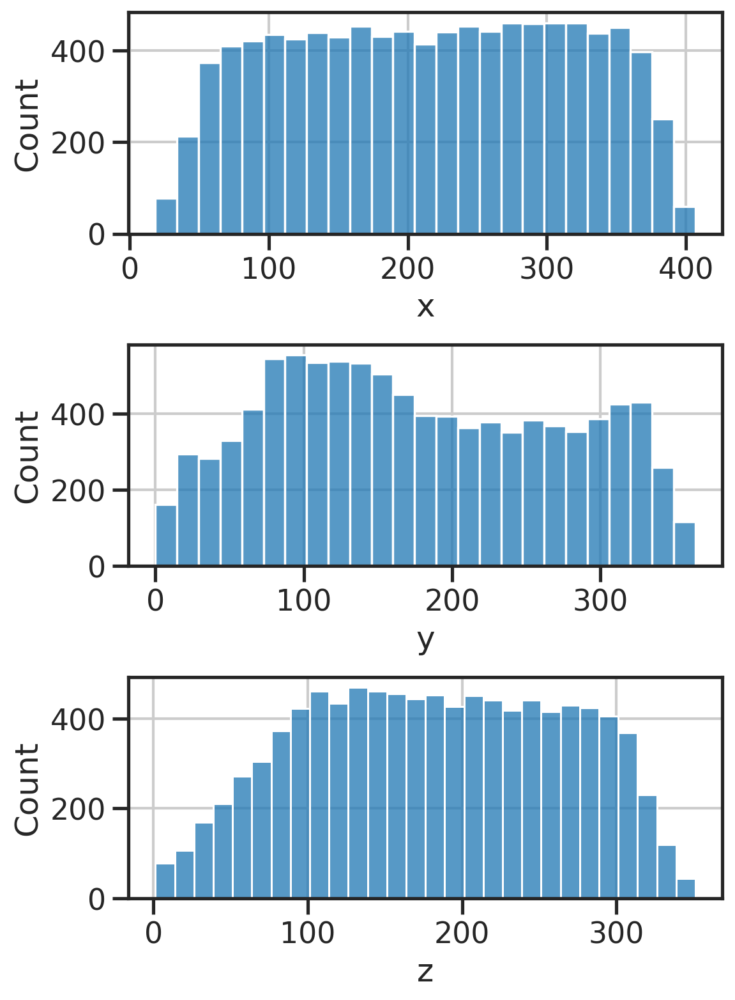

Text(0.5, 0, 'area')

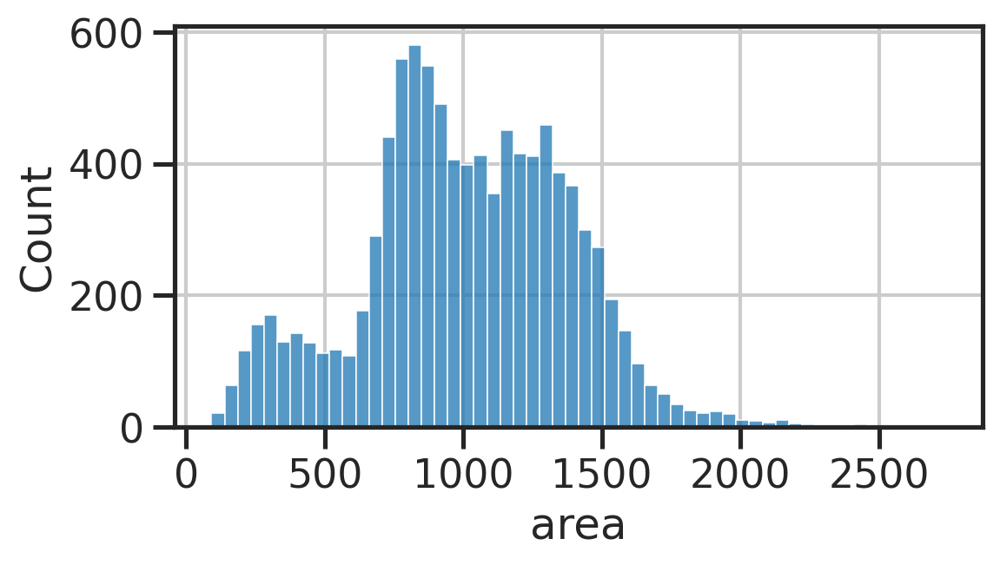

In [14]:
x = df['x'].values
y = df['y'].values
z = df['z'].values

fig, axs = plt.subplots(3, 1, figsize=(1*6, 3*3))
ax = axs[0]
sns.histplot(x, ax=ax)
ax.set_xlabel('x')

ax = axs[1]
sns.histplot(y, ax=ax)
ax.set_xlabel('y')

ax = axs[2]
sns.histplot(z, ax=ax)
ax.set_xlabel('z')

fig.subplots_adjust(hspace=0.5)
plt.show()

fig, ax = plt.subplots(1, 1, figsize=(1*6, 1*3))
sns.histplot(df['area'].values, ax=ax)
ax.set_xlabel('area')

Text(0.5, 0, 'Genes')

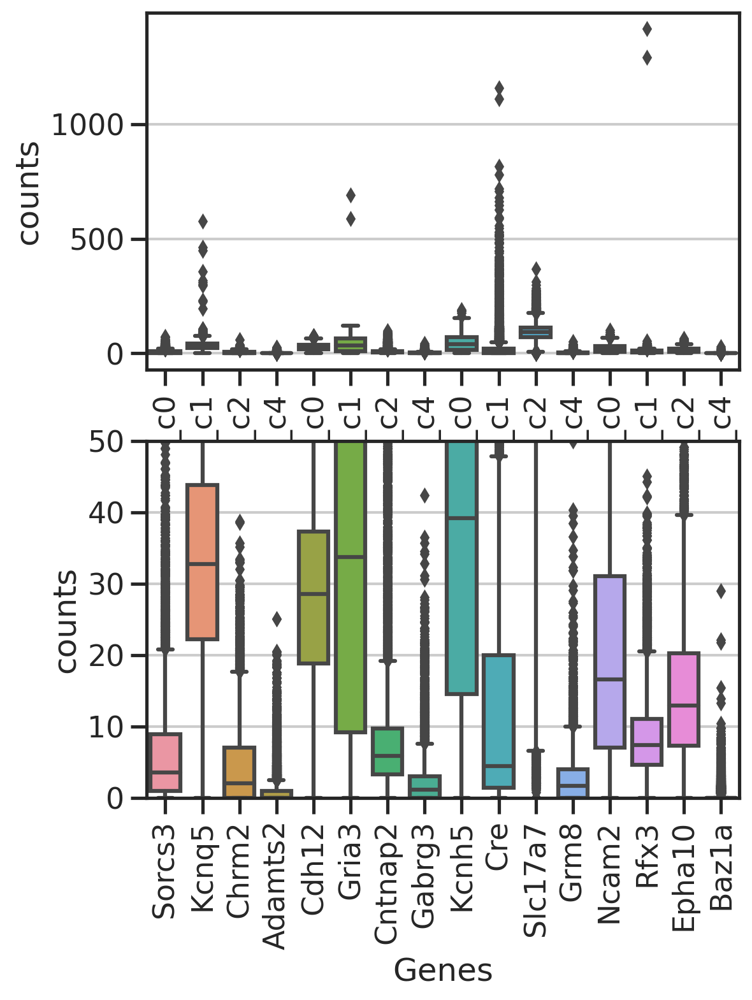

In [15]:
fig, axs = plt.subplots(2, 1, figsize=(6*1,4*2))
ax = axs[0]
sns.boxplot(data=dfnew[ftrs_cols], ax=ax)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90)
ax.set_ylabel('counts')
ax.set_xlabel('Genes')

ax = axs[1]
sns.boxplot(data=dfnew[ftrs_cols], ax=ax)
ax.set_xticklabels([gene_names[ftr_col] for ftr_col in ftrs_cols], rotation=90)
ax.set_ylim([0,50])
ax.set_ylabel('counts')
ax.set_xlabel('Genes')

In [16]:
# binary analysis
ybins = np.linspace(0,400,100)
dfnew['ybin'] = pd.cut(dfnew['y'], bins=ybins)

xbins = np.linspace(0,400,100)
dfnew['xbin'] = pd.cut(dfnew['x'], bins=xbins)

zbins = np.linspace(0,400,100)
dfnew['zbin'] = pd.cut(dfnew['z'], bins=zbins)

bins_zb = np.linspace(0,400,9).astype(int)
print(bins_zb)
dfnew['bins_zb'] = pd.cut(dfnew['z'], bins=bins_zb)

bins_zb_4p = np.linspace(0,400,5).astype(int)
print(bins_zb_4p)
dfnew['bins_zb_4p'] = pd.cut(dfnew['z'], bins=bins_zb_4p)

bins_xb = np.linspace(0,400,9).astype(int)
print(bins_zb)
dfnew['bins_xb'] = pd.cut(dfnew['x'], bins=bins_xb)

[  0  50 100 150 200 250 300 350 400]
[  0 100 200 300 400]
[  0  50 100 150 200 250 300 350 400]


# z-sectioning visuals
- bin into zbin
- plot for each zbin

In [17]:
def gen_palette(dfnew, col):
    # set global colorbar
    hue_order = np.unique(dfnew[col]) 
    ncat = len(hue_order)
    if ncat > 5:
        cmap = 'Paired'
    else:
        cmap = 'tab10'
    palette = {clst: clr for clst, clr in zip(hue_order, sns.color_palette(cmap, ncat))}
    return palette

In [18]:
def view_z_sections(dfnew, sp_x, sp_y, col=None, cmap='coolwarm', title=None, vmaxp=95, vminp=0):
    """
    """
    # assert len(dfnew['bins_zb'].unique())-1 == 8 # 8 intervals
    
    # set global colorbar
    if col is not None:
        vmax = np.percentile(dfnew[col].values, vmaxp)
        vmin = -vmax*0.1
        # vmin = np.percentile(dfnew[col].values, vminp)
        
    fig, axs = plt.subplots(2, 4, figsize=(4*4,2*4), sharex=True, sharey=True)
    for i, (thisbin, dfsub) in enumerate(dfnew.groupby('bins_zb')):
        ax = axs.flat[i]
        ax.grid(False)

        x = dfsub[sp_x].values
        y = dfsub[sp_y].values
        if col is not None:
            c = dfsub[col].values
            g = ax.scatter(x, y, c=c, s=10, cmap=cmap, vmax=vmax, vmin=vmin,
                           edgecolor='none', 
                          )
        else:
            g = ax.scatter(x, y, s=10, c='gray', 
                           edgecolor='none', 
                          )
            
        sns.despine(ax=ax)
        ax.set_aspect('equal')
        ax.set_title(f" z: {thisbin}", loc='left', y=0.95)#va='top')#va='top', y=0.96)

        if i%4 == 0:
            ax.set_ylabel(sp_y)
        if i >= 4:
            ax.set_xlabel(sp_x)

    if col is not None:
        cax = fig.add_axes([0.93, 0.3, 0.01, 0.3])
        fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')
    fig.subplots_adjust(hspace=0.1, wspace=0.05)
    if title is not None:
        fig.suptitle(title, fontsize=20, y=0.92)
    plt.show()

In [19]:
def view_z_sections_4panels(dfnew, sp_x, sp_y, col=None, cmap='coolwarm', title=None, vmaxp=95, vminp=0):
    """
    """
    # assert len(dfnew['bins_zb_4p'].unique())-1 == 4 # 4 intervals
    
    # set global colorbar
    if col is not None:
        vmax = np.percentile(dfnew[col].values, vmaxp)
        vmin = -vmax*0.1
        # vmin = np.percentile(dfnew[col].values, vminp)
        
    fig, axs = plt.subplots(1, 4, figsize=(4*4,1*4), sharex=True, sharey=True)
    for i, (thisbin, dfsub) in enumerate(dfnew.groupby('bins_zb_4p')):
        ax = axs.flat[i]
        ax.grid(False)

        x = dfsub[sp_x].values
        y = dfsub[sp_y].values
        if col is not None:
            c = dfsub[col].values
            g = ax.scatter(x, y, c=c, s=8, cmap=cmap, vmax=vmax, vmin=vmin,
                           edgecolor='none', 
                          )
        else:
            g = ax.scatter(x, y, s=8, c='gray', 
                           edgecolor='none', 
                          )
            
        sns.despine(ax=ax)
        ax.set_aspect('equal')
        ax.set_title(f" z: {thisbin}", loc='left', y=0.95)#va='top')#va='top', y=0.96)

        if i == 0:
            ax.set_ylabel(sp_y)
        ax.set_xlabel(sp_x)

    if col is not None:
        cax = fig.add_axes([0.93, 0.3, 0.01, 0.3])
        fig.colorbar(g, cax=cax, label='', shrink=0.3, aspect=10, ticks=[0,vmax], orientation='vertical')
    fig.subplots_adjust(hspace=0.1, wspace=0.05)
    if title is not None:
        fig.suptitle(title, fontsize=20, y=0.92)
    plt.show()

In [20]:
def view_z_sections_labels(dfnew, sp_x, sp_y, col, palette=None, title=None):
    """
    """
    # assert len(dfnew['bins_zb'].unique())-1 == 8 # 8 intervals
    
    # set global colorbar
    hue_order = np.unique(dfnew[col]) 
    ncat = len(hue_order)
    if ncat > 5:
        cmap = 'Paired'
    else:
        cmap = 'tab10'
    if palette is None:
        palette = {clst: clr for clst, clr in zip(hue_order, sns.color_palette(cmap, ncat))}
        
    fig, axs = plt.subplots(2, 4, figsize=(4*4,2*4), sharex=True, sharey=True)
    for i, (thisbin, dfsub) in enumerate(dfnew.groupby('bins_zb')):
        ax = axs.flat[i]
        ax.grid(False)
        if i == 4-1:
            legend = True
        else:
            legend = False
        g = sns.scatterplot(data=dfsub, x=sp_x, y=sp_y, hue=col, 
                            hue_order=hue_order, palette=palette,
                            s=10, 
                            edgecolor='none', 
                            ax=ax,
                            legend=legend,
                          )
        sns.despine(ax=ax)
        ax.set_aspect('equal')
        ax.set_title(f" z: {thisbin}", loc='left', y=0.95)#va='top')#va='top', y=0.96)

        if i%4 == 0:
            ax.set_ylabel(sp_y)
        if i >= 4:
            ax.set_xlabel(sp_x)
        if i == 4-1:
            ax.legend(bbox_to_anchor=(1,1))

    fig.subplots_adjust(hspace=0.1, wspace=0.05)
    if title is not None:
        fig.suptitle(title, fontsize=20, y=0.92)
    plt.show()

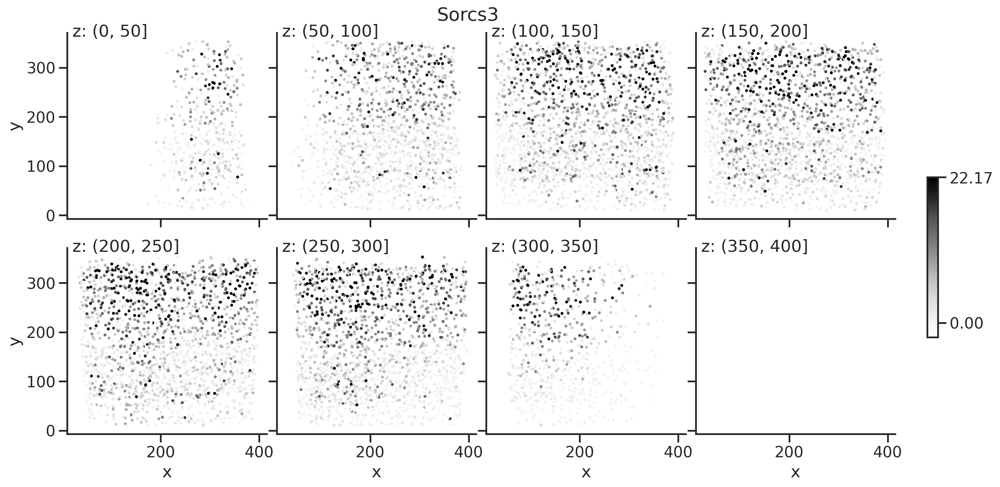

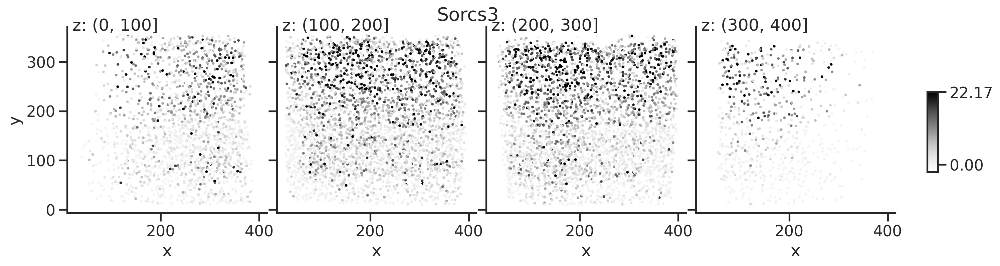

In [21]:
sp_x, sp_y = 'x', 'y'
col = ftrs_order[0]
title = gene_names[col]
view_z_sections(dfnew, sp_x, sp_y, col=col, cmap='Greys', title=title)
view_z_sections_4panels(dfnew, sp_x, sp_y, col=col, cmap='Greys', title=title)

# hierarchical clustering

In [22]:
def gen_discrete_colors(N):
    """
    """
    fig, ax = plt.subplots(figsize=(6, 1))
    fig.subplots_adjust(bottom=0.5)
    cmap = matplotlib.cm.jet
    norm = matplotlib.colors.BoundaryNorm(1+np.arange(N), cmap.N, extend='max')
    dismap = matplotlib.cm.ScalarMappable(norm=norm, cmap=cmap)
    fig.colorbar(dismap,
                 cax=ax, orientation='horizontal')
    plt.show()
    
    palette = {i: dismap.to_rgba(i)[:3] for i in 1+np.arange(N)}
    plt.figure(figsize=(5,1))
    plt.scatter(1+np.arange(N), [0]*N, c=[palette[p] for p in palette.keys()])
    plt.show()
    return palette, dismap

(8535,) (4,)
(8535,) (12,)
(8535,) (25,)


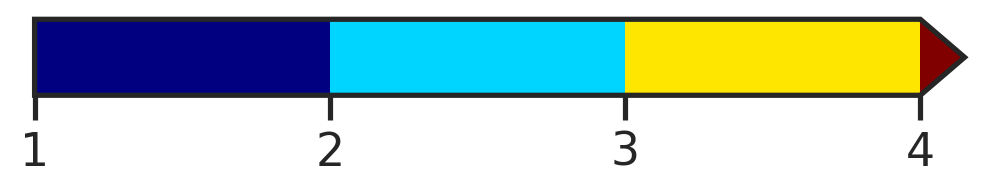

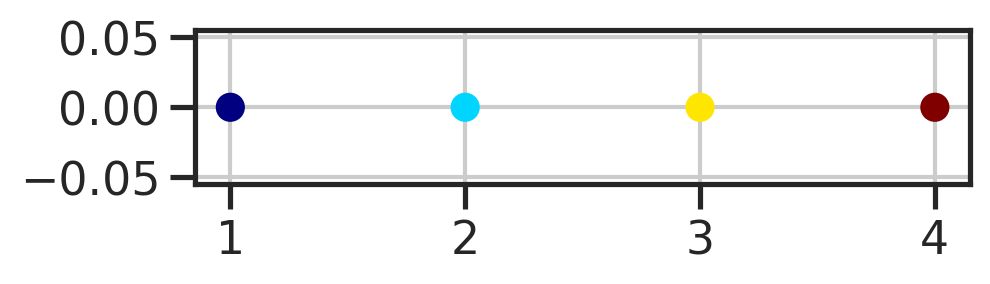

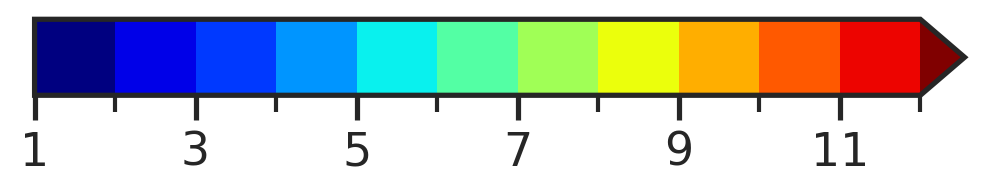

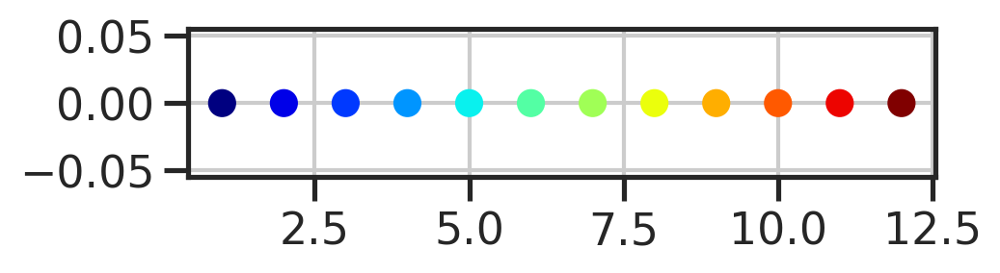

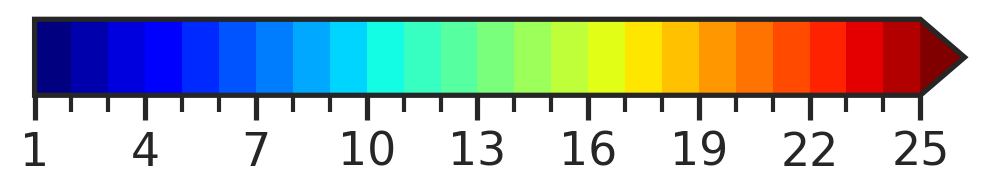

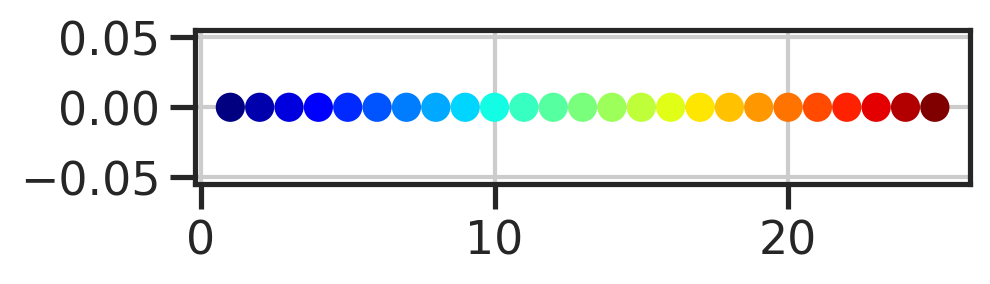

In [23]:
# sch
col_link = sch.linkage(mat_ftrs.T, method='ward', metric='euclidean')
col_order = sch.dendrogram(col_link, no_plot=True)['leaves']

row_link = sch.linkage(mat_ftrs, method='ward', metric='euclidean')
row_order = sch.dendrogram(row_link, p=30, truncate_mode='none', no_plot=True)['leaves']

# get clusters
clsts1 = sch.fcluster(row_link, 100, criterion='distance')
clsts2 = sch.fcluster(row_link,  50, criterion='distance')
clsts3 = sch.fcluster(row_link,  30, criterion='distance')

print(clsts1.shape, np.unique(clsts1).shape)
print(clsts2.shape, np.unique(clsts2).shape)
print(clsts3.shape, np.unique(clsts3).shape)

dfnew['clst_l1'] = clsts1
dfnew['clst_l2'] = clsts2
dfnew['clst_l3'] = clsts3

# colors
palette1, dismap1 = gen_discrete_colors(len(np.unique(clsts1)))
palette2, dismap2 = gen_discrete_colors(len(np.unique(clsts2)))
palette3, dismap3 = gen_discrete_colors(len(np.unique(clsts3)))

In [24]:
genes_order_v2 = np.hstack([
    mat_ftrs.columns[col_order],
    ['Cre'],
])
ftrs_order_v2 = channel_names.loc[genes_order_v2].values
ftrs_order_v2

array(['r3_c2', 'r3_c1', 'r3_c4', 'r1_c4', 'r5_c1', 'r5_c4', 'r1_c0',
       'r4_c4', 'r3_c0', 'r4_c0', 'r1_c2', 'r5_c0', 'r5_c2', 'r1_c1',
       'r4_c2', 'r4_c1'], dtype=object)

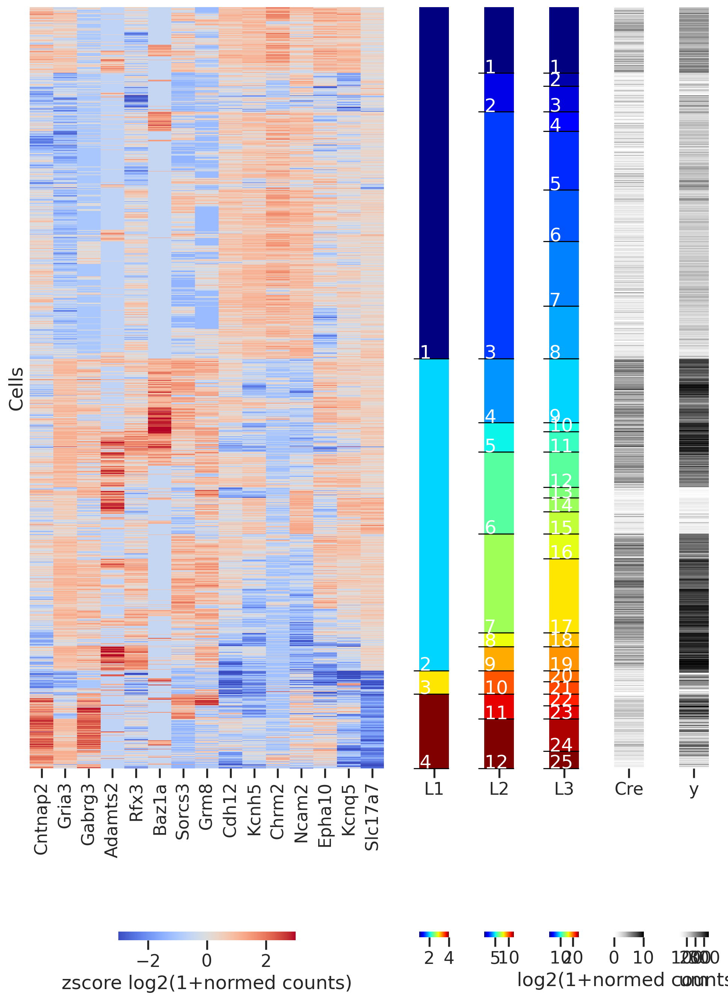

In [25]:
fig = plt.figure(figsize=(10,15))
axd = fig.subplot_mosaic("A"*6+"BCDEF")
ax = axd["A"]
sns.heatmap(
    mat_ftrs.iloc[row_order,col_order],
    yticklabels=False,
    cmap='coolwarm',
    cbar_kws=dict(shrink=0.5, location='bottom', label='zscore log2(1+normed counts)'),
    vmax=3, vmin=-3,
    ax=ax,
)
ax.set_ylabel('Cells')

for i, (ax, col) in enumerate(zip(
    (axd["B"], axd["C"], axd["D"]),
    ('clst_l1', 'clst_l2', 'clst_l3'),
    )):
    vec = dfnew[col].values
    sns.heatmap(
        dfnew[[col]].rename(columns={col: col.replace('clst_l', 'L')}).iloc[row_order],
        yticklabels=False,
        cmap='jet',
        cbar_kws=dict(location='bottom', aspect=5, label=''),
        ax=ax,
    )
    ax.set_ylabel('')
    positions = np.cumsum(np.unique(vec, return_counts=True)[1])
    ax.hlines(positions, xmin=-0.2, xmax=1, linewidth=1, linestyle='-', color='k', clip_on=False)
    for i, pos in enumerate(positions):
        ax.text(0, pos, i+1, color='white')

ax = axd["E"]
sns.heatmap(
    mat_cre.iloc[row_order],
    yticklabels=False,
    cmap='Greys',
    cbar_kws=dict(location='bottom', aspect=5, label='log2(1+normed counts)'),
    ax=ax,
)
ax.set_ylabel('')

ax = axd["F"]
sns.heatmap(
    dfnew[['y']].iloc[row_order], 
    yticklabels=False,
    cmap='Greys',
    cbar_kws=dict(location='bottom', aspect=5, label='um'),
    # vmin=0,
    ax=ax,
)
ax.set_ylabel('')
fig.tight_layout()

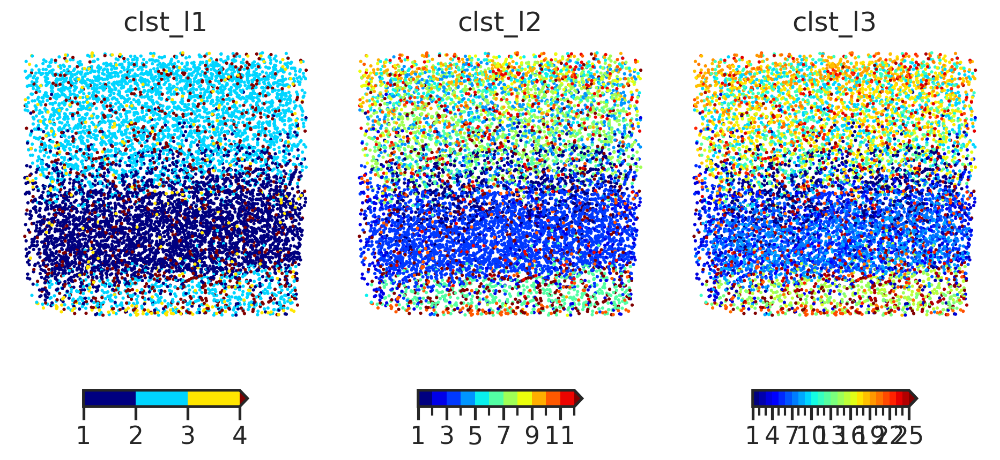

In [26]:
sp_x, sp_y = 'x', 'y'
fig, axs = plt.subplots(1,3,figsize=(4*3,5*1), sharey=True, sharex=True)
# cbar_ax = fig.add_axes([0.92, 0.5, 0.01, 0.2])
for i, (col, palette, dismap, ax) in enumerate(zip(['clst_l1', 'clst_l2', 'clst_l3'], 
                                                   [ palette1,  palette2,  palette3],
                                                   [ dismap1,   dismap2,   dismap3],
                                                   axs.flat)):
    x = dfnew[sp_x].values
    y = dfnew[sp_y].values
    c = dfnew[col].values
    
    ax.grid(False)
    g = ax.scatter(x, y, c=pd.Series(palette)[c], s=5, edgecolor='none',)
    sns.despine(ax=ax)
    ax.set_title(col)
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.axis('off')
    fig.colorbar(dismap, ax=ax, orientation='horizontal', shrink=0.5, aspect=10)
    
fig.subplots_adjust(hspace=0.1, wspace=0.02)

/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/matplotlib/cbook/__init__.py:1062: VisibleDeprecationWarning: Creating an ndarray from ragged nested sequences (which is a list-or-tuple of lists-or-tuples-or ndarrays with different lengths or shapes) is deprecated. If you meant to do this, you must specify 'dtype=object' when creating the ndarray.
  x = np.asanyarray(x)


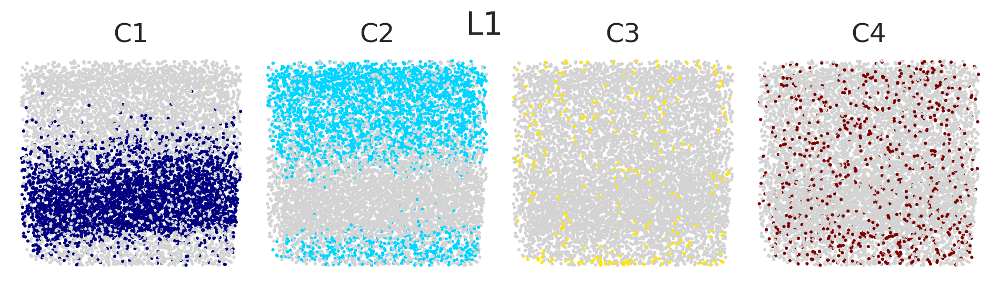

In [27]:
sp_x, sp_y = 'x', 'y'
col = 'clst_l1'
palette = palette1
dismap = dismap1
n = len(dfnew[col].unique())
nx = min(6,n)
ny = int((n+nx-1)/nx)
suptitle = 'L1'

fig, axs = plt.subplots(ny,nx,figsize=(3*nx,3*ny), sharey=True, sharex=True)
for i, ax in enumerate(axs.flat):
    x = dfnew[sp_x].values
    y = dfnew[sp_y].values
    c = dfnew[col].values
    
    ax.grid(False)
    g = ax.scatter(x, y, c=[palette[_c] if i+1==_c else 'lightgray' for _c in c], s=5, edgecolor='none',)
    
    sns.despine(ax=ax)
    ax.set_title(f"C{i+1}")
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.axis('off')
    
fig.suptitle(suptitle)
fig.subplots_adjust(hspace=0.1, wspace=0.02)

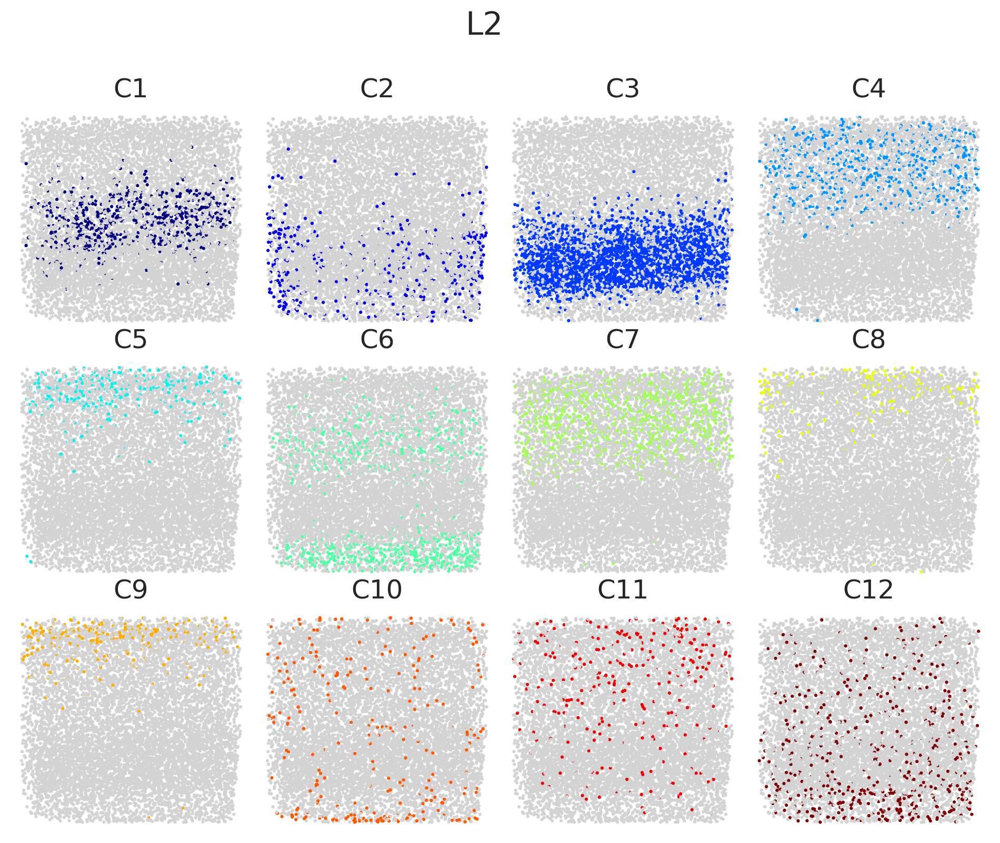

In [28]:
sp_x, sp_y = 'x', 'y'
col = 'clst_l2'
palette = palette2
dismap = dismap2
n = len(dfnew[col].unique())
nx = min(4,n)
ny = int((n+nx-1)/nx)
suptitle = 'L2'

fig, axs = plt.subplots(ny,nx,figsize=(3*nx,3*ny), sharey=True, sharex=True)
for i, ax in enumerate(axs.flat):
    x = dfnew[sp_x].values
    y = dfnew[sp_y].values
    c = dfnew[col].values
    
    ax.grid(False)
    g = ax.scatter(x, y, c=[palette[_c] if i+1==_c else 'lightgray' for _c in c], s=5, edgecolor='none',)
    
    sns.despine(ax=ax)
    ax.set_title(f"C{i+1}")
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    ax.axis('off')
    
fig.suptitle(suptitle)
fig.subplots_adjust(hspace=0.1, wspace=0.02)

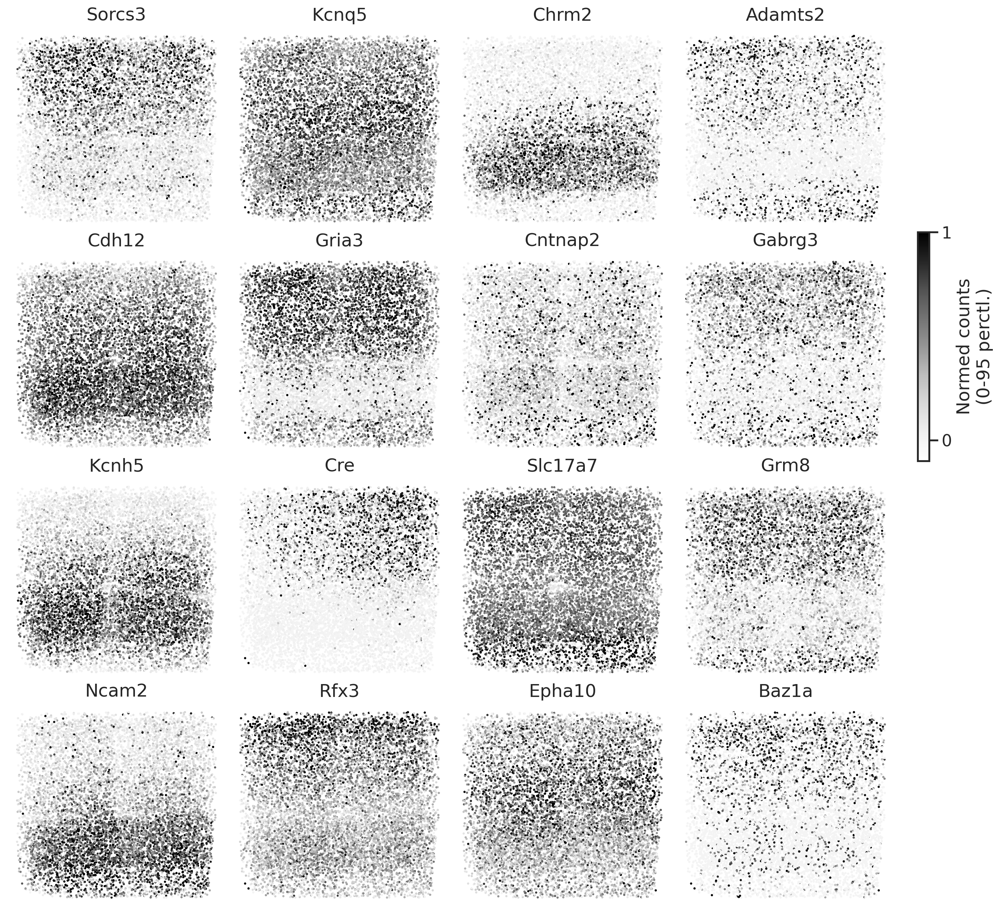

In [29]:
sp_x, sp_y = 'x', 'y'
fig, axs = plt.subplots(4,4,figsize=(4*4,4*4), sharey=True, sharex=True)
cbar_ax = fig.add_axes([0.92, 0.5, 0.01, 0.2])
for i, (col, ax) in enumerate(zip(ftrs_order, axs.flat)):
    x = dfnew[sp_x].values
    y = dfnew[sp_y].values
    c = dfnew[col].values
    vmax=np.percentile(c, 95)
    
    ax.axis('off')
    ax.grid(False)
    g = ax.scatter(x, y, c=c/vmax, s=5, edgecolor='none', cmap='Greys', vmax=1, vmin=-0.1) #vmax, vmin=-0.1*vmax)
    sns.despine(ax=ax)
    ax.set_title(gene_names[col.replace('_log2', '')])
    ax.set_xlabel(sp_x)
    ax.set_ylabel(sp_y)
    ax.set_aspect('equal')
    
fig.colorbar(g, cax=cbar_ax, label='Normed counts\n(0-95 perctl.)', aspect=5, shrink=0.3, ticks=[0, 1])
fig.subplots_adjust(hspace=0.1, wspace=0.02)

# co-expression, clustering, cluster enrichment of expression

/tmp/ipykernel_27472/3569861413.py:24: UserWarning: Ignoring `palette` because no `hue` variable has been assigned.
  g = sns.scatterplot(data=dfsub, x=sp_x, y=sp_y, hue=col,


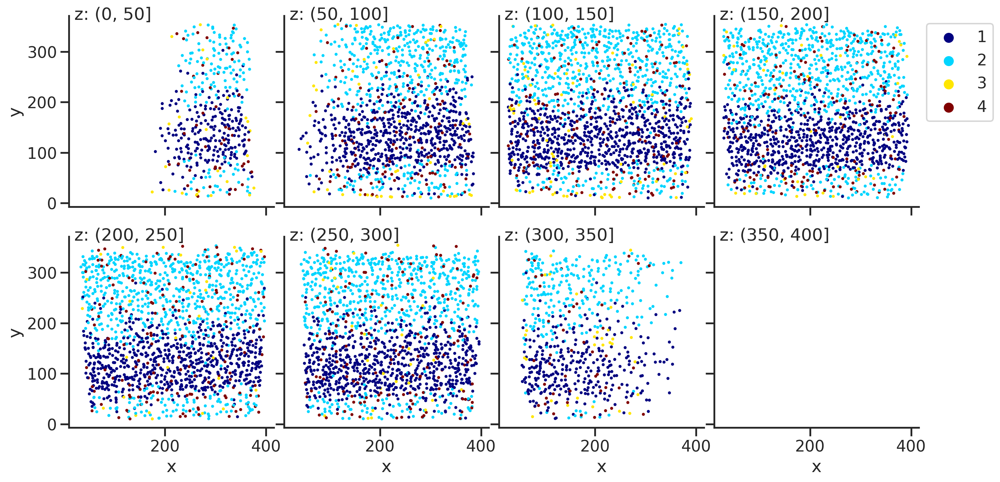

In [30]:
sp_x, sp_y = 'x', 'y'
col = 'clst_l1'
view_z_sections_labels(dfnew, sp_x, sp_y, col, palette=palette1, title=None)

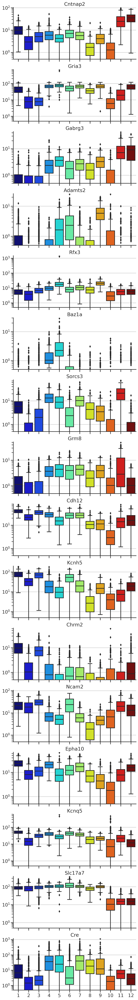

In [31]:
group = 'clst_l2'
palette = palette2
data = dfnew

fig, axs = plt.subplots(16,1,figsize=(8*1,4*16), sharex=True)
grouporder = np.unique(data[group])
for i, col in enumerate(ftrs_order_v2):
    ax = axs.flat[i]
    # col = ftrs_order[0]

    sns.boxplot(data=data, x=group, order=grouporder, palette=palette, y=col, ax=ax,)
    sns.despine(ax=ax)
    ax.set_ylim(ymin=0.5)
    ax.set_title(gene_names[col])
    ax.set_ylabel("") #gene_names[col])
    ax.set_xlabel("") #gene_names[col])
    ax.set_yscale('log')
fig.subplots_adjust(wspace=0.3)

<Axes: xlabel='clst_l2'>

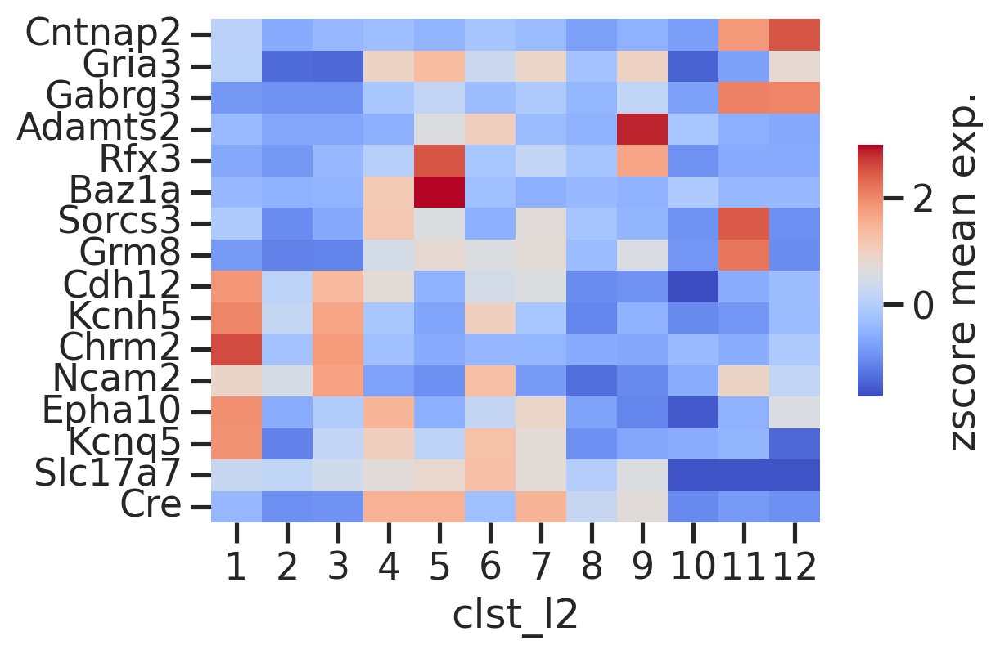

In [32]:
group = 'clst_l2'
dfmean = dfnew.groupby(group)[ftrs_order_v2].mean()
dfmean = basicu.zscore(dfmean, axis=0)

fig, ax = plt.subplots(figsize=(6,4))
sns.heatmap(dfmean.T, ax=ax, 
            yticklabels=[gene_names[col] for col in dfmean.columns],
            cmap='coolwarm', cbar_kws=dict(label='zscore mean exp.', shrink=0.5, aspect=10))

# correlate

In [33]:
from scipy.stats import spearmanr
from sklearn.linear_model import LinearRegression

In [34]:
def plot_corr(x, y, ax, ylabel=True):
    """
    """
    ax.scatter(x, y, s=1)
    r, p = spearmanr(x, y)
    ax.set_xlabel(x.name)
    if ylabel:
        ax.set_ylabel(y.name)
    ax.set_title(f"r={r:.2f}, p={p:.2g}")
    
    _df = pd.DataFrame(np.vstack([x, y]).T)
    _df[2] = pd.qcut(_df[0], 20, duplicates='drop')
    _df = _df.groupby(2).mean()
    ax.plot(_df[0], _df[1], color='C1')
    
    return 

In [35]:
mat_ftrs2 = dfnew.filter(regex='_log2$').filter(regex='^((?!r4_c1).)*$') #.columns
mat_ftrs2.columns = [gene_names[col[:-len('_log2')]] for col in mat_ftrs2.columns]
mat_cre2 = dfnew[['r4_c1_log2']].rename(columns={'r4_c1_log2': 'Cre'})

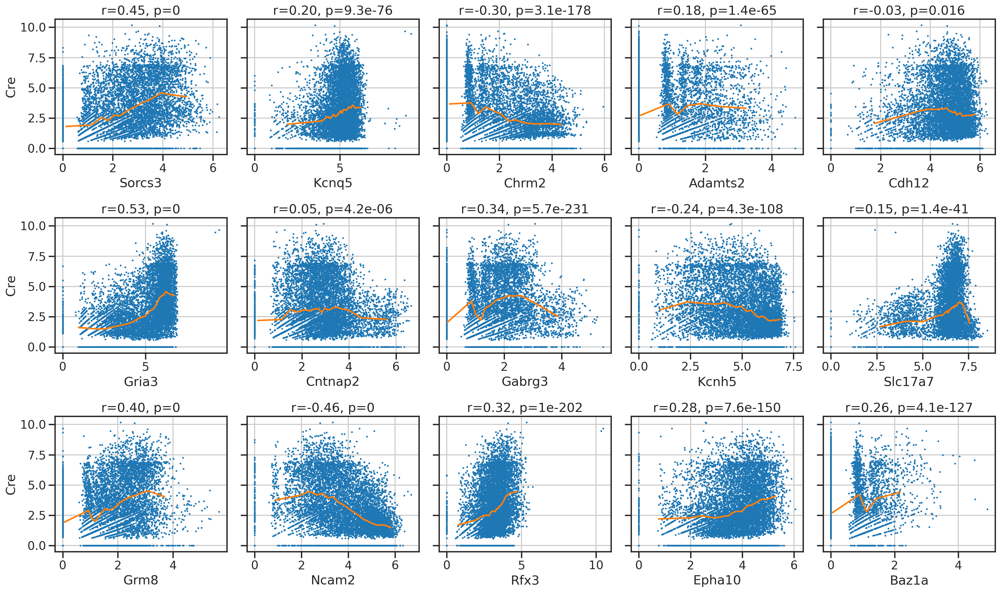

In [36]:
fig, axs = plt.subplots(3,5,figsize=(5*4,3*4), sharey=True)
for i in range(15):
    ax = axs.flat[i]
    _x = mat_ftrs2.iloc[:,i] 
    _y = mat_cre2.iloc[:,0]

    if i % 5 == 0:
        ylabel = True
    else:
        ylabel = False
        
    plot_corr(_x, _y, ax, ylabel=ylabel)
fig.tight_layout()

In [37]:
lr = LinearRegression()
lr.fit(mat_ftrs2.values, mat_cre2.values)
r2 = lr.score(mat_ftrs2.values, mat_cre2.values)
ypred = lr.predict(mat_ftrs2)
ypred = pd.Series(ypred[:,0], name='pred')
r2

/u/home/f/f7xiesnm/.conda/envs/napari/lib/python3.9/site-packages/sklearn/base.py:432: UserWarning: X has feature names, but LinearRegression was fitted without feature names
  warnings.warn(


0.44031650165411884

In [38]:
hybrid_ftrs = np.hstack([mat_ftrs2, dfnew[['y']]/np.max(dfnew['y'])])
lr = LinearRegression()
lr.fit(hybrid_ftrs, mat_cre2.values)
r2 = lr.score(hybrid_ftrs, mat_cre2.values)
ypred2 = lr.predict(hybrid_ftrs)
ypred2 = pd.Series(ypred2[:,0], name='pred')
r2

0.5090929439398195

Text(0.5, 0, 'All genes (linear model)')

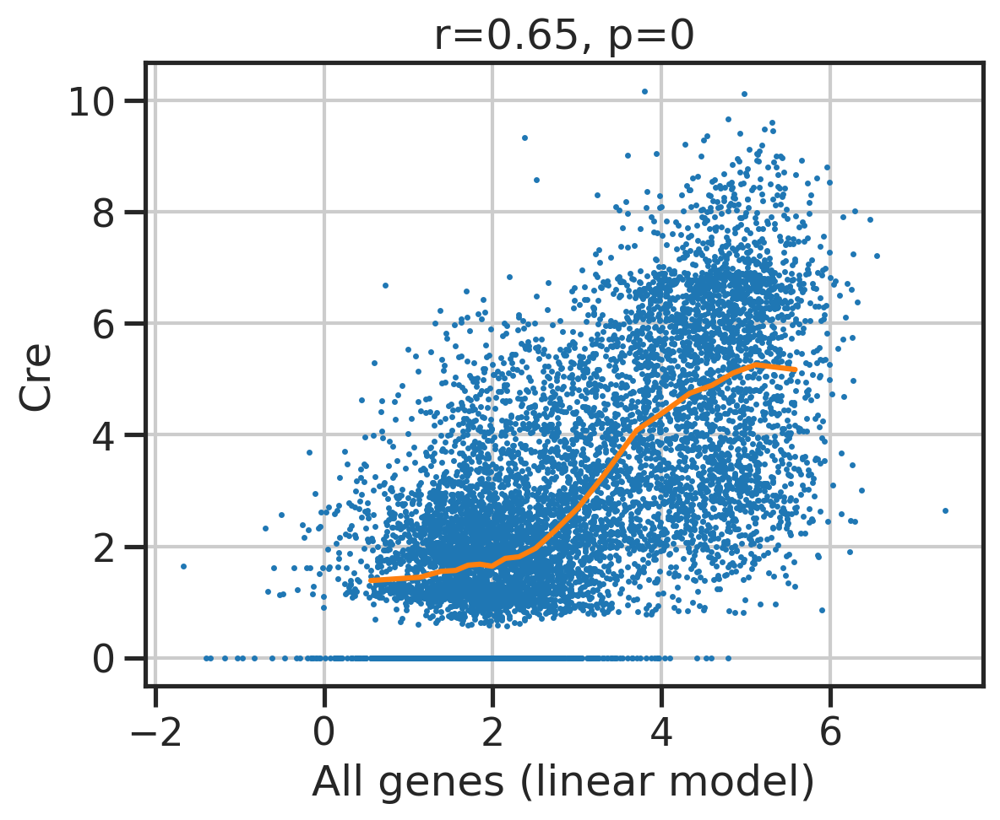

In [39]:
_x = ypred
_y = mat_cre2.iloc[:,0]

fig, ax = plt.subplots()
plot_corr(_x, _y, ax) #.iloc[:,0], ax)
ax.set_xlabel('All genes (linear model)')

Text(0.5, 0, 'All genes + y (linear model)')

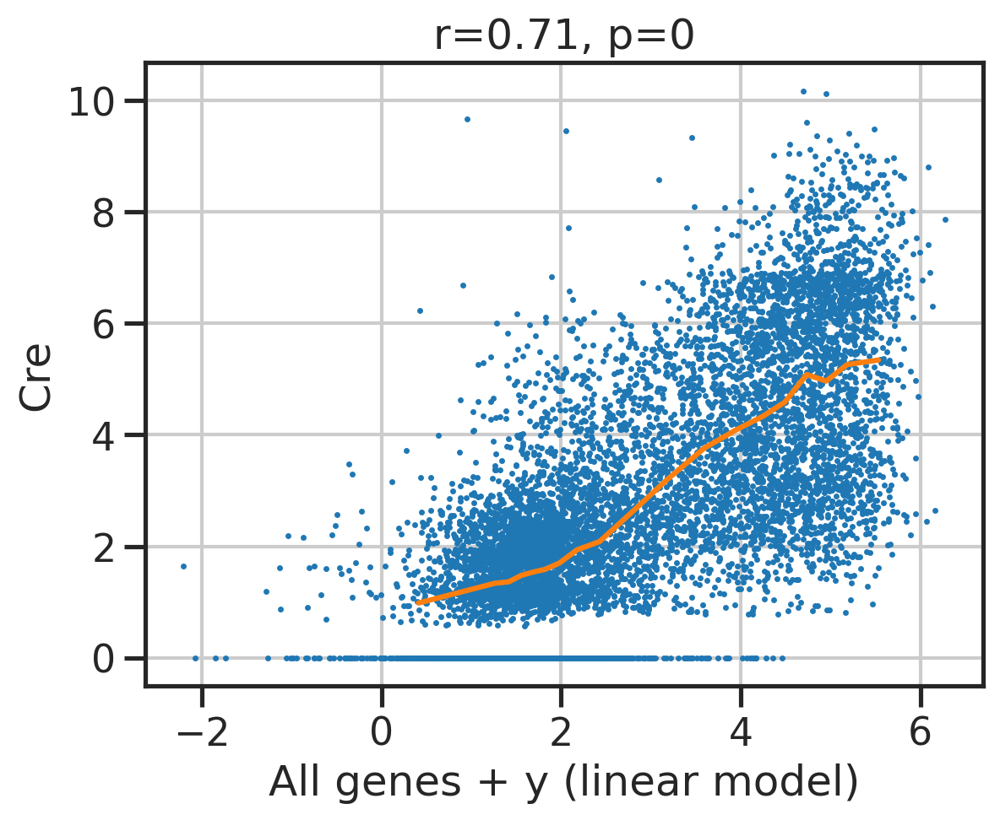

In [40]:
_x = ypred2
_y = mat_cre2.iloc[:,0]

fig, ax = plt.subplots()
plot_corr(_x, _y, ax) #.iloc[:,0], ax)
ax.set_xlabel('All genes + y (linear model)')

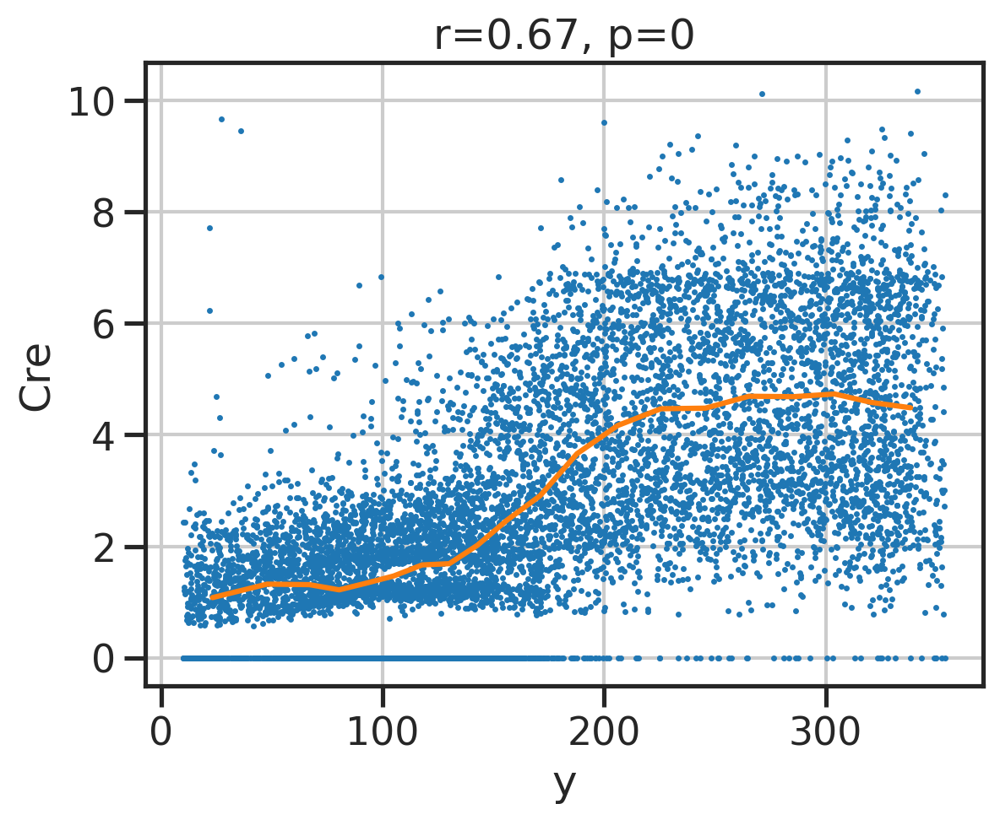

In [41]:
fig, ax = plt.subplots()
plot_corr(dfnew['y'], mat_cre2.iloc[:,0], ax) #.iloc[:,0], ax)

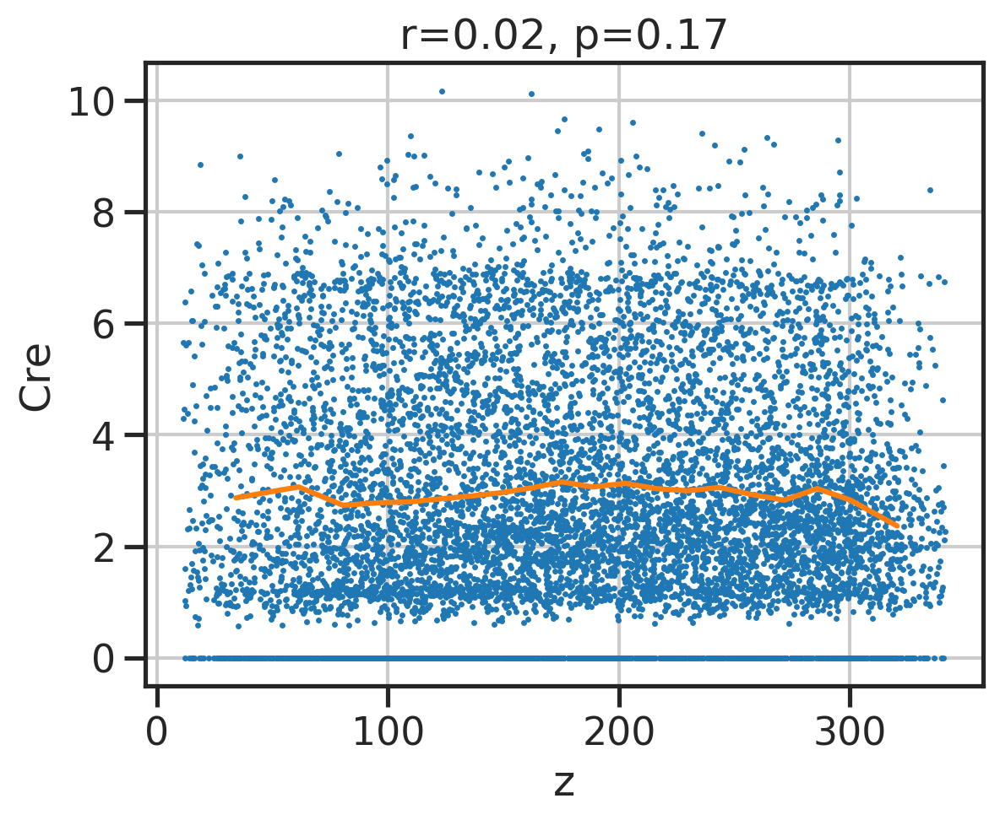

In [42]:
fig, ax = plt.subplots()
plot_corr(dfnew['z'], mat_cre2.iloc[:,0], ax) #.iloc[:,0], ax)

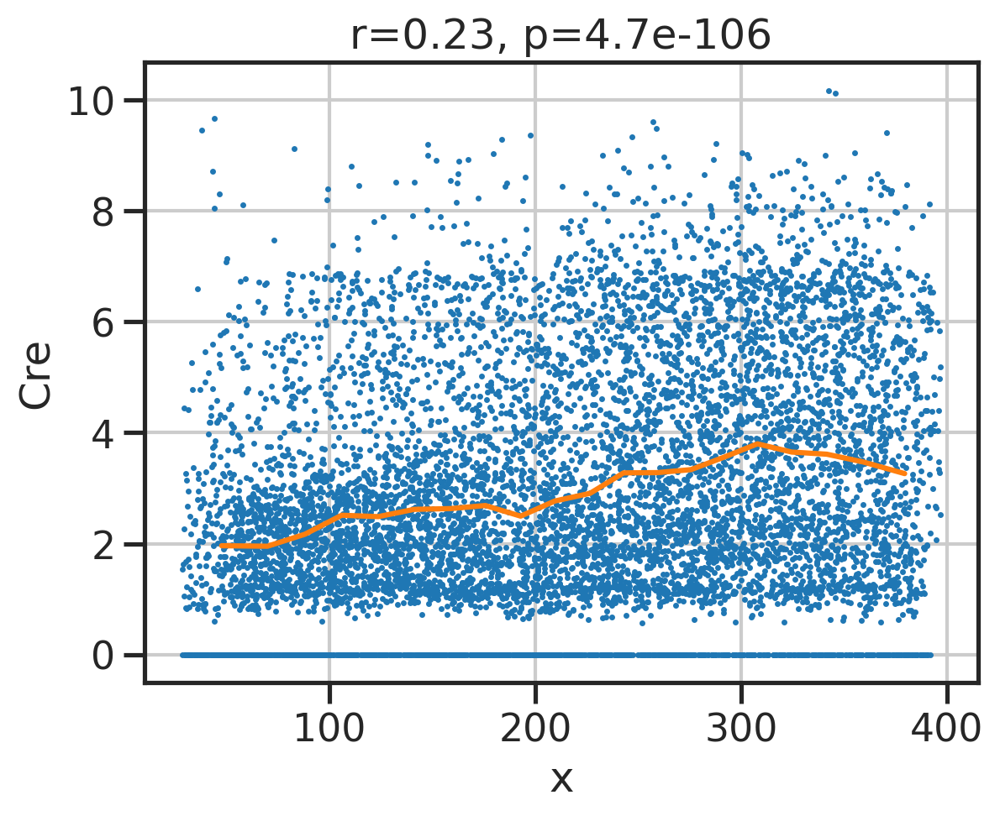

In [43]:
fig, ax = plt.subplots()
plot_corr(dfnew['x'], mat_cre2.iloc[:,0], ax) #.iloc[:,0], ax)

# spatial analysis

In [44]:
def get_clst2clst_counts(clsts, knn):
    """Given cluster labels (for each cell) and spatial neighbors (indices; including self), 
    Calculate how many connections (neighbor pairs) each cluster pairs have.
    Return this information as a cluster-by-cluster count matrix
    
    `clsts` is an array of cluster labels (integers; start from zero and goes continuously up)
    """
    from scipy import sparse
    k = knn.shape[1]
    knn_clsts = clsts[knn] # cluster label for kNN
    n_unq_clsts = len(np.unique(clsts)) # number of clusters

    shape   = (n_unq_clsts, n_unq_clsts)
    _self   = knn_clsts[:,0]
    _others = knn_clsts[:,1:]
    rows = np.repeat(_self, (k-1)) # repeat 
    cols = np.hstack(_others)
    assert len(rows) == len(cols) 
    data = np.repeat(1, len(rows))
    clst2clst_counts = sparse.coo_matrix((data, (rows, cols)), shape=shape).todense() 
    clst2clst_counts = (clst2clst_counts + clst2clst_counts.T) # each connection counted twice.
    return clst2clst_counts

In [45]:
xyz = dfnew[['x', 'y', 'z']].values
clsts = dfnew['clst_l2'].values
unq_clsts = np.unique(clsts)
xyz, clsts, np.unique(clsts), xyz.shape, clsts.shape, unq_clsts

(array([[250.1674182 , 263.3638413 , 158.00267917],
        [255.20768177, 326.84984779, 295.63229056],
        [347.25440084, 333.93125339, 158.60934154],
        ...,
        [101.02995186, 295.37356375, 326.46002063],
        [138.24550601,  14.20580256, 134.18133922],
        [205.3838976 , 112.13723573, 241.54437859]]),
 array([ 7,  7,  9, ..., 10, 10, 10], dtype=int32),
 array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12], dtype=int32),
 (8535, 3),
 (8535,),
 array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12], dtype=int32))

In [46]:
# for each cell, get their k nearest spatial neighbors
from sklearn.neighbors import NearestNeighbors
from statsmodels.stats.multitest import multipletests

k = 1+20 # 1(self) + n nearest neighbors
knn_fit = NearestNeighbors(n_neighbors=k).fit(xyz)
knn = knn_fit.kneighbors(xyz, return_distance=False)
print(knn.shape)

(8535, 21)


In [47]:
c2c_counts = get_clst2clst_counts(clsts-1, knn)
print(c2c_counts.shape)

Nshuff = 1000
c2c_counts_shuff_all = []
for i in range(Nshuff):
    clsts_shuff = clsts[np.random.choice(len(clsts), size=len(clsts), replace=False)]
    c2c_counts_shuff = get_clst2clst_counts(clsts_shuff-1, knn)
    c2c_counts_shuff_all.append(c2c_counts_shuff)
c2c_counts_shuff_all = np.array(c2c_counts_shuff_all)
c2c_counts_shuff_mean = np.mean(c2c_counts_shuff_all, axis=0)
print(c2c_counts_shuff_all.shape, c2c_counts_shuff_mean.shape)

(12, 12)
(1000, 12, 12) (12, 12)


In [48]:
pvals = 1/Nshuff+1/Nshuff*2*np.minimum(np.sum(np.array([c2c_counts]) < c2c_counts_shuff_all, axis=0),
                                 np.sum(np.array([c2c_counts]) > c2c_counts_shuff_all, axis=0),
                                )
rejs, qvals, _, _ = multipletests(pvals.reshape(-1,), method='fdr_bh')
rejs  = rejs.reshape(pvals.shape)
qvals = qvals.reshape(pvals.shape)

In [49]:
enriched = np.log2((1+c2c_counts)/(1+c2c_counts_shuff_mean))
enriched[~rejs] = 0 #= enriched*rejs.astype(int)

In [50]:
links = sch.linkage(enriched, method='average')
clstidx_spatial_order = sch.dendrogram(links, no_plot=True)['leaves']
clstidx_spatial_order

[2, 1, 0, 9, 5, 11, 10, 3, 6, 7, 4, 8]

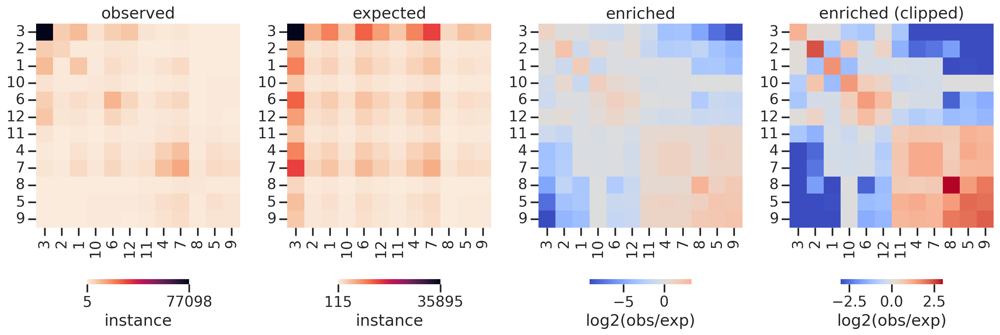

In [51]:
fig, axs = plt.subplots(1,4,figsize=(4*4,1*6))
ax = axs[0]
_min, _max = np.min(c2c_counts), np.max(c2c_counts)
sns.heatmap(c2c_counts[clstidx_spatial_order,:][:,clstidx_spatial_order], 
            xticklabels=unq_clsts[clstidx_spatial_order],
            yticklabels=unq_clsts[clstidx_spatial_order],
            ax=ax, 
            vmin=_min,
            vmax=_max,
            cbar_kws=dict(shrink=0.5, orientation='horizontal', ticks=[_min, _max], label='instance'),
            cmap='rocket_r',
           )
ax.set_aspect('equal')
ax.set_title('observed')

ax = axs[1]
_min, _max = np.min(c2c_counts_shuff_mean), np.max(c2c_counts_shuff_mean)
sns.heatmap(c2c_counts_shuff_mean[clstidx_spatial_order,:][:,clstidx_spatial_order], 
            xticklabels=unq_clsts[clstidx_spatial_order],
            yticklabels=unq_clsts[clstidx_spatial_order],
            ax=ax,
            vmin=_min,
            vmax=_max,
            cbar_kws=dict(shrink=0.5, orientation='horizontal', ticks=[_min, _max], label='instance'),
            cmap='rocket_r',
           )
ax.set_aspect('equal')
ax.set_title('expected')

ax = axs[2]
sns.heatmap(enriched[clstidx_spatial_order,:][:,clstidx_spatial_order], 
            xticklabels=unq_clsts[clstidx_spatial_order],
            yticklabels=unq_clsts[clstidx_spatial_order],
            ax=ax,
            cbar_kws=dict(shrink=0.5, orientation='horizontal', label='log2(obs/exp)'),
            cmap='coolwarm',
            # vmax=2,vmin=-2,
            center=0,
           )
ax.set_aspect('equal')
ax.set_title('enriched')

ax = axs[3]
sns.heatmap(enriched[clstidx_spatial_order,:][:,clstidx_spatial_order], 
            xticklabels=unq_clsts[clstidx_spatial_order],
            yticklabels=unq_clsts[clstidx_spatial_order],
            ax=ax,
            cbar_kws=dict(shrink=0.5, orientation='horizontal', label='log2(obs/exp)'),
            cmap='coolwarm',
            vmax=3,vmin=-3,
           )
ax.set_aspect('equal')
ax.set_title('enriched (clipped)')
fig.tight_layout()

## finer grained 

In [52]:
cond = dfnew['y']>200
xyz = dfnew[cond][['x', 'y', 'z']].values
clsts = dfnew[cond]['clst_l2'].values
unq_clsts = np.unique(clsts)
xyz, clsts, np.unique(clsts), xyz.shape, clsts.shape, unq_clsts

(array([[250.1674182 , 263.3638413 , 158.00267917],
        [255.20768177, 326.84984779, 295.63229056],
        [347.25440084, 333.93125339, 158.60934154],
        ...,
        [231.44827021, 231.07071742, 317.75357216],
        [113.08543581, 257.33456658, 340.61992664],
        [101.02995186, 295.37356375, 326.46002063]]),
 array([ 7,  7,  9, ..., 10,  8, 10], dtype=int32),
 array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12], dtype=int32),
 (3342, 3),
 (3342,),
 array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12], dtype=int32))

In [53]:
# for each cell, get their k nearest spatial neighbors
from sklearn.neighbors import NearestNeighbors

k = 1+20 # 1(self) + n nearest neighbors
knn_fit = NearestNeighbors(n_neighbors=k).fit(xyz)
knn = knn_fit.kneighbors(xyz, return_distance=False)
print(knn.shape)

(3342, 21)


In [54]:
c2c_counts = get_clst2clst_counts(clsts-1, knn)
print(c2c_counts.shape)

Nshuff = 1000
c2c_counts_shuff_all = []
for i in range(Nshuff):
    clsts_shuff = clsts[np.random.choice(len(clsts), size=len(clsts), replace=False)]
    c2c_counts_shuff = get_clst2clst_counts(clsts_shuff-1, knn)
    c2c_counts_shuff_all.append(c2c_counts_shuff)
c2c_counts_shuff_all = np.array(c2c_counts_shuff_all)
c2c_counts_shuff_mean = np.mean(c2c_counts_shuff_all, axis=0)
print(c2c_counts_shuff_all.shape, c2c_counts_shuff_mean.shape)

(12, 12)
(1000, 12, 12) (12, 12)


In [55]:
pvals = 1/Nshuff+1/Nshuff*2*np.minimum(np.sum(np.array([c2c_counts]) < c2c_counts_shuff_all, axis=0),
                                 np.sum(np.array([c2c_counts]) > c2c_counts_shuff_all, axis=0),
                                )
rejs, qvals, _, _ = multipletests(pvals.reshape(-1,), method='fdr_bh')
rejs  = rejs.reshape(pvals.shape)
qvals = qvals.reshape(pvals.shape)

In [56]:
enriched = np.log2((1+c2c_counts)/(1+c2c_counts_shuff_mean))
enriched[~rejs] = 0 #= enriched*rejs.astype(int)

In [57]:
links = sch.linkage(enriched, method='ward')
clstidx_spatial_order = sch.dendrogram(links, no_plot=True)['leaves']
clstidx_spatial_order

[2, 1, 0, 5, 10, 11, 9, 3, 6, 7, 4, 8]

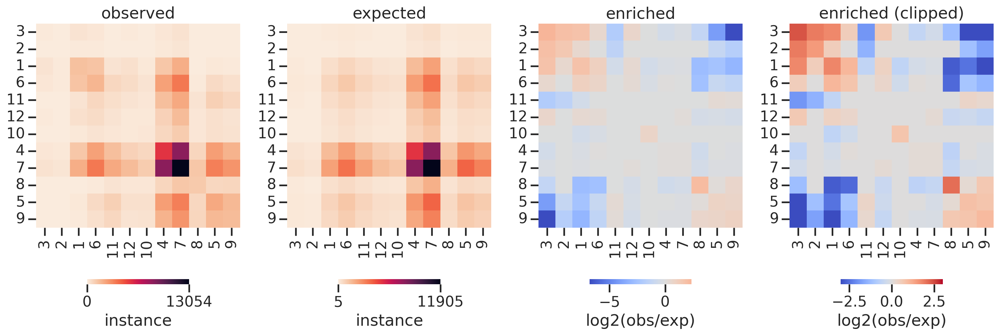

In [58]:
fig, axs = plt.subplots(1,4,figsize=(4*4,1*6))
ax = axs[0]
_min, _max = np.min(c2c_counts), np.max(c2c_counts)
sns.heatmap(c2c_counts[clstidx_spatial_order,:][:,clstidx_spatial_order], 
            xticklabels=unq_clsts[clstidx_spatial_order],
            yticklabels=unq_clsts[clstidx_spatial_order],
            ax=ax, 
            vmin=_min,
            vmax=_max,
            cbar_kws=dict(shrink=0.5, orientation='horizontal', ticks=[_min, _max], label='instance'),
            cmap='rocket_r',
           )
ax.set_aspect('equal')
ax.set_title('observed')

ax = axs[1]
_min, _max = np.min(c2c_counts_shuff_mean), np.max(c2c_counts_shuff_mean)
sns.heatmap(c2c_counts_shuff_mean[clstidx_spatial_order,:][:,clstidx_spatial_order], 
            xticklabels=unq_clsts[clstidx_spatial_order],
            yticklabels=unq_clsts[clstidx_spatial_order],
            ax=ax,
            vmin=_min,
            vmax=_max,
            cbar_kws=dict(shrink=0.5, orientation='horizontal', ticks=[_min, _max], label='instance'),
            cmap='rocket_r',
           )
ax.set_aspect('equal')
ax.set_title('expected')

ax = axs[2]
sns.heatmap(enriched[clstidx_spatial_order,:][:,clstidx_spatial_order], 
            xticklabels=unq_clsts[clstidx_spatial_order],
            yticklabels=unq_clsts[clstidx_spatial_order],
            ax=ax,
            cbar_kws=dict(shrink=0.5, orientation='horizontal', label='log2(obs/exp)'),
            cmap='coolwarm',
            # vmax=2,vmin=-2,
            center=0,
           )
ax.set_aspect('equal')
ax.set_title('enriched')

ax = axs[3]
sns.heatmap(enriched[clstidx_spatial_order,:][:,clstidx_spatial_order], 
            xticklabels=unq_clsts[clstidx_spatial_order],
            yticklabels=unq_clsts[clstidx_spatial_order],
            ax=ax,
            cbar_kws=dict(shrink=0.5, orientation='horizontal', label='log2(obs/exp)'),
            cmap='coolwarm',
            vmax=3,vmin=-3,
           )
ax.set_aspect('equal')
ax.set_title('enriched (clipped)')
fig.tight_layout()

# Save

In [59]:
# output = os.path.join(pth_dat, "clustering_results_Nov4.csv")
# dfnew.to_csv(output)
# !chmod 444 $output
# # !head $output

In [60]:
# palette1_ = {}
# for i, item in palette1.items():
#     palette1_[int(i)] = (matplotlib.colors.to_hex(item))
    
# palette2_ = {}
# for i, item in palette2.items():
#     palette2_[int(i)] = (matplotlib.colors.to_hex(item))
    
# palette3_ = {}
# for i, item in palette3.items():
#     palette3_[int(i)] = (matplotlib.colors.to_hex(item))

In [61]:
# import json

# output2 = os.path.join(pth_dat, "clustering_results_config_Nov4.json")
# config = {
#     'gene_names': gene_names,
#     'palette1':   palette1_,
#     'palette2':   palette2_,
#     'palette3':   palette3_,
# }

# with open(output2, 'w') as fh:
#     json.dump(config, fh)
# !chmod 444 $output2